#  Predicting Cadets Likely to Struggle in Physics I

While the United States Coast Guard Academy (USCGA) recruits high-achieving students from across the nation and around the globe, every year we have cadets who struggle to pass Physics I.  Failure to pass Physics has many undesirable consequences, including lowering a cadet's GPA, potentially delaying graduation and deployment to the operational fleet, and possibly even leading to a cadet's disenrollment from the Academy.  It is in the best interests of both the United States Coast Guard and the cadets themselves to do whatever we can to help cadets to pass Physics I the first time they take it.  Early intervention is vital, and academic support programs are in place to help struggling cadets.  However, at-risk cadets are difficult to identify until they have already failed an exam or two, at which point they are already in distress.  This tool seeks to mitigate that problem by predicting - right at the start of the semester - the cadets most at risk to have an unfavorable outcome in Physics I (defined here as earning a final grade of C- or worse), for the purpose of getting them into an academic support program at the earliest sign of trouble.

## Model Training

This tool is a ML model that identifies cadets most at risk to struggle in Physics I based on their prior performance at the USCGA and in high school.  Both the training and prediction data require access to cadet PII, including grades and GPAs.  Consequently, the tool is presented as a Jupyter notebook for use by the USCGA Vice Provost for Academic Affairs or their designee (e.g. the Physics I Course Coordinator).

In it's current form, the model has been trained on cadet data for Class Years 2020-2025.  You should not retrain the model unless you wish to update it based on the performance of classes since then.  If you only want to identify at-risk cadets fot the upcoming semester, proceed to the "Predictions" section.

### Import and merge training data, import target data

First, we'll import the institutional training data.  The current code assumes the cadet data will be presented as a .csv file with 15 fields in each row. The first field is a unique identifier (i.e. Cadet Code or equivalent).  The other fields and their data types are:
* Gender (string)
* Academic Class Year  (integer)  
* Ethnicity (string)
* Math Placement (integer, CGA math class number) 
* Most recent CGA GPA (decimal)
* HS GPA (decimal)
* HS GPA Scale (4.0, 100, etc.) (decimal)
* Standardized Test Used (SAT or ACT) (string) 
* Math Score (SAT equivalent) (integer)  
* Verbal Score (SAT equivalent) (integer)  
* Times enrolled in Calculus I (integer) 
* Calculus 1 Last Grade (letter) 
* Calculus I Last Quality Points (decimal)
* Times enrolled in Physics I (integer, 1 unless repeating)  

In [1]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

In [2]:
import numpy as np
import pandas as pd

train_instit = pd.read_csv("./Train-instit.csv", index_col=0)

print(type(train_instit))
train_instit.shape

<class 'pandas.core.frame.DataFrame'>


(1684, 14)

In [3]:
train_instit.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1684 entries, 1 to 1684
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Gender           1684 non-null   object 
 1   AcademicClassYr  1684 non-null   int64  
 2   Ethnicity        1671 non-null   object 
 3   MathPlacement    1684 non-null   int64  
 4   LastGPA          1679 non-null   float64
 5   HSGPA            1684 non-null   float64
 6   MaxHS_GPA_Scale  1684 non-null   float64
 7   TestUsed         1684 non-null   object 
 8   MaxMath          1684 non-null   int64  
 9   MaxVerbal        1684 non-null   int64  
 10  Calc1Number      1684 non-null   int64  
 11  Calc1LastGrade   1364 non-null   object 
 12  Calc1LastQP      1348 non-null   float64
 13  PhysicsITimes    1684 non-null   int64  
dtypes: float64(4), int64(6), object(4)
memory usage: 197.3+ KB


The provided institutional data includes the demographic information "Gender" and "Ethnicity".  We do not want these categories to bias our results, so we'll drop them.  We'll also drop the Class Year (not predictive) and "PhysicsITimes", as we'll bring that in with the departmental data.

In [4]:
train_instit.drop(columns=['Gender', 'AcademicClassYr', 'Ethnicity', 'PhysicsITimes'], inplace=True)

In [5]:
train_instit['MathPlacement'] = train_instit['MathPlacement'].astype(str) #Set MathPlacement (class number) as string

Now we'll import departmental data.  This also starts with a unique identifier for each cadet that matches those in the institutional data.  The other fields are "Phys1Grade" (a cadet's Physics 1 final grade for each attempt) and "Physics1Times".  Note that REGIS (the CGA academic record system) may provide only the most recent value for Physics1Times, so the data for cadets repeating Physics 1 in any semester had to be manually updated to match attempt instances with their final grades for each attempt.  Future updates to the training data should be ssimilarly pre-processed.

In [6]:
train_dept = pd.read_csv("./Train-dept-v2.csv", index_col=0)

print(type(train_dept))
train_dept.shape

<class 'pandas.core.frame.DataFrame'>


(1702, 3)

In [7]:
train_df=train_dept.merge(train_instit, on='RecordNum', how='left')

In [8]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1702 entries, 1 to 1457
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Phys1Grade       1563 non-null   object 
 1   PhysicsITimes    1702 non-null   int64  
 2   P1_PrevGrade     1702 non-null   object 
 3   MathPlacement    1702 non-null   object 
 4   LastGPA          1697 non-null   float64
 5   HSGPA            1702 non-null   float64
 6   MaxHS_GPA_Scale  1702 non-null   float64
 7   TestUsed         1702 non-null   object 
 8   MaxMath          1702 non-null   int64  
 9   MaxVerbal        1702 non-null   int64  
 10  Calc1Number      1702 non-null   int64  
 11  Calc1LastGrade   1381 non-null   object 
 12  Calc1LastQP      1365 non-null   float64
dtypes: float64(4), int64(4), object(5)
memory usage: 186.2+ KB


Let's find the mean of the standardized test scores "MaxMath" and "MaxVerbal" in case we need to fill any missing values in future cohorts.

In [9]:
SAT_Math_avg = int(train_df.MaxMath.mean())
SAT_Verbal_avg = int(train_df.MaxVerbal.mean())
print(SAT_Math_avg, SAT_Verbal_avg)

655 652


### Data Cleaning

We dropped drop the 'Gender' and 'Ethnicity' columns during data import, on the grounds that these may bias our results.  We also dropped the "AcademicClassYr" column, since year-on-year performance should be roughly similar.  We dropped them from the prediction set as well.  We'll use "Calc1QP" as the Calc 1 performance indicator, so we'll drop "Calc1LastGrade" too.

In [10]:
train_inst=train_df.drop(columns=['Calc1LastGrade'])

In [11]:
train_inst.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1702 entries, 1 to 1457
Data columns (total 12 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Phys1Grade       1563 non-null   object 
 1   PhysicsITimes    1702 non-null   int64  
 2   P1_PrevGrade     1702 non-null   object 
 3   MathPlacement    1702 non-null   object 
 4   LastGPA          1697 non-null   float64
 5   HSGPA            1702 non-null   float64
 6   MaxHS_GPA_Scale  1702 non-null   float64
 7   TestUsed         1702 non-null   object 
 8   MaxMath          1702 non-null   int64  
 9   MaxVerbal        1702 non-null   int64  
 10  Calc1Number      1702 non-null   int64  
 11  Calc1LastQP      1365 non-null   float64
dtypes: float64(4), int64(4), object(4)
memory usage: 172.9+ KB


There appear to be 5 missing values in the "LastGPA" column.  These are likely due to disenrollments at the beginning of the semester, and should be dropped.

In [12]:
train_inst.dropna(subset=['LastGPA'], inplace=True)

About 300 records are missing values for 'Calc1LastGrade' and 'Calc1LastQP'.  This could be because their math placement exam placed them into a class higher than Calc 1, or because they hadn't yet taken Calc 1.  If the former, their effective Calc 1 grade should be 'A' and their Calc 1 Quality Points should be 4.0.  For those cadets, their effective Calc1Number should also be set to 1.  For the others, their QP should be 0.0.

In [13]:
train_inst['Calc1LastQP'] = train_inst.apply(lambda row: 
                                             0.0 
                                             if pd.isnull(row['Calc1LastQP']) and int(row['MathPlacement']) <= 3111
                                             else row['Calc1LastQP'], axis=1)

train_inst['Calc1LastQP'] = train_inst.apply(lambda row: 
                                             4.0 
                                             if pd.isnull(row['Calc1LastQP']) and int(row['MathPlacement']) > 3111
                                             else row['Calc1LastQP'], axis=1)

train_inst['Calc1Number'] = train_inst.apply(lambda row: 
                                             1 
                                             if int(row['MathPlacement']) > 3111
                                             else row['Calc1Number'], axis=1)

Let's get the HS GPAs on the same scale.

In [14]:
train_inst['HS_Gpct'] = train_inst.HSGPA / train_inst.MaxHS_GPA_Scale

In [15]:
train_inst.HS_Gpct.replace([np.inf, -np.inf], np.nan, inplace=True)  #taking care of some pesky inf values

About 300 cadets in our training data don't have HS GPAs listed!  For now, we'll fill them with their Academy GPA.

In [16]:
train_inst['HS_Gpct'] = train_inst.apply(lambda row: 
                                             row['LastGPA']/4.0 
                                             if pd.isnull(row['HS_Gpct'])
                                             else row['HS_Gpct'], axis=1)

Finally, we need to handle the Physics 1 grades (the thing we're predicting).

Many Physics 1 grades (the target of our predictions) are missing from the training data.  In many cases, these are due to "validation": i.e., testing out of Physics 1.  These cadets almost universally placed into Calc 1 or higher.  For now, we'll assume that any missing Physics 1 grade where the cadet was placed into MATH 3211 was a validation.

In [17]:
train_inst['Phys1Grade'] = train_inst.apply(lambda row: 
                                             'V' 
                                             if pd.isnull(row['Phys1Grade']) and int(row['MathPlacement']) >= 3111
                                             else row['Phys1Grade'], axis=1)

In [18]:
train_inst.Phys1Grade.value_counts()

Phys1Grade
B+    280
A     272
B     198
C+    163
B-    151
A-    146
V     127
H     121
C     110
C-     51
F      36
D      20
W      14
S       1
Name: count, dtype: int64

In [19]:
train_inst.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1697 entries, 1 to 1457
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Phys1Grade       1690 non-null   object 
 1   PhysicsITimes    1697 non-null   int64  
 2   P1_PrevGrade     1697 non-null   object 
 3   MathPlacement    1697 non-null   object 
 4   LastGPA          1697 non-null   float64
 5   HSGPA            1697 non-null   float64
 6   MaxHS_GPA_Scale  1697 non-null   float64
 7   TestUsed         1697 non-null   object 
 8   MaxMath          1697 non-null   int64  
 9   MaxVerbal        1697 non-null   int64  
 10  Calc1Number      1697 non-null   int64  
 11  Calc1LastQP      1697 non-null   float64
 12  HS_Gpct          1697 non-null   float64
dtypes: float64(5), int64(4), object(4)
memory usage: 185.6+ KB


Grades of W or S are usually due to extenuating circumstances.  We'll drop them, along with the 7 rows still missing grades.

In [20]:
valid_grades = ['V', 'H', 'A', 'A-', 'B+', 'B', 'B-', 'C+', 'C', 'C-', 'D', 'F']

In [21]:
df = train_inst[train_inst.Phys1Grade.isin(valid_grades) == True]

In [22]:
df.Phys1Grade.value_counts()

Phys1Grade
B+    280
A     272
B     198
C+    163
B-    151
A-    146
V     127
H     121
C     110
C-     51
F      36
D      20
Name: count, dtype: int64

Note that the classes here are HIGHLY unbalanced.  Only about 1 in 15 cadets earns a grade of C- or worse.  We will beed to address this in the model training section.

In [23]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1675 entries, 1 to 1457
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Phys1Grade       1675 non-null   object 
 1   PhysicsITimes    1675 non-null   int64  
 2   P1_PrevGrade     1675 non-null   object 
 3   MathPlacement    1675 non-null   object 
 4   LastGPA          1675 non-null   float64
 5   HSGPA            1675 non-null   float64
 6   MaxHS_GPA_Scale  1675 non-null   float64
 7   TestUsed         1675 non-null   object 
 8   MaxMath          1675 non-null   int64  
 9   MaxVerbal        1675 non-null   int64  
 10  Calc1Number      1675 non-null   int64  
 11  Calc1LastQP      1675 non-null   float64
 12  HS_Gpct          1675 non-null   float64
dtypes: float64(5), int64(4), object(4)
memory usage: 183.2+ KB


As a last step, we will convert our Physics 1 grades into our target labels.  Grades of C- or higher are "successful", while those below are not.

In [24]:
#Successful_grades = ['V', 'H', 'A', 'A-', 'B+', 'B', 'B-', 'C+', 'C']  #moved C- to the At Risk category to help balance classes

In [25]:
def GradeConverter(row):
    successful_grades = ['V', 'H', 'A', 'A-', 'B+', 'B', 'B-', 'C+', 'C']
    
    if row['Phys1Grade'] in successful_grades:
        outcome = 0
    else:
        outcome = 1
        
    return outcome    

In [26]:
df['Phys1_outcome'] = df.apply(lambda row: GradeConverter(row), axis=1)

/tmp/ipykernel_9459/3163381256.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Phys1_outcome'] = df.apply(lambda row: GradeConverter(row), axis=1)


In [27]:
df.Phys1_outcome.value_counts()

Phys1_outcome
0    1568
1     107
Name: count, dtype: int64

In [28]:
model_input = df.copy()

In [29]:
features_to_use = ['MathPlacement','HS_Gpct', 'MaxMath', 'MaxVerbal', 'LastGPA', 'Calc1Number', 'Calc1LastQP', 'PhysicsITimes', 'P1_PrevGrade']

X_m = model_input[features_to_use]
y_m = model_input['Phys1_outcome']

In [30]:
X_m.head()

,MathPlacement,HS_Gpct,MaxMath,MaxVerbal,LastGPA,Calc1Number,Calc1LastQP,PhysicsITimes,P1_PrevGrade
RecordNum,,,,,,,,,
1,3111,0.9500,630,630,2.98,1,2.3,1,N
2,3111,0.8988,800,580,3.06,1,3.0,1,N
3,3111,0.8150,550,600,3.26,1,3.0,1,N
4,3111,0.7525,630,540,2.60,1,1.0,1,N
5,3111,0.9400,680,600,3.52,1,3.0,1,N


In [31]:
y_m.head()

RecordNum
1    0
2    0
3    0
4    0
5    0
Name: Phys1_outcome, dtype: int64

Now we'll encode the columns in preparation for sampling and classification

We'll need to select and transform the columns we want to feed into our predictor.  MathPlacement is categorical and will need to be OneHotEncoded.  We'll also keep HS_Gpct, LastGPA, MaxMath, MaxVerbal, Calc1Number, Calc1LastQP, and PhysicsITimes.  Phys1_outcome is what we'll be trying to predict.

In [32]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder

columns_to_encode = ['MathPlacement', 'P1_PrevGrade']
ohe = OneHotEncoder()

ohe_trans = ColumnTransformer([
    ('OHE', ohe, columns_to_encode)], 
    remainder='passthrough')

X_encoded = ohe_trans.fit_transform(X_m)
Xenc_cols = ohe_trans.get_feature_names_out()

In [33]:
X_encoded.shape

(1675, 16)

In [34]:
Xenc_cols

array(['OHE__MathPlacement_3107', 'OHE__MathPlacement_3111',
       'OHE__MathPlacement_3115', 'OHE__MathPlacement_3117',
       'OHE__MathPlacement_3211', 'OHE__MathPlacement_3213',
       'OHE__MathPlacement_3215', 'OHE__P1_PrevGrade_F',
       'OHE__P1_PrevGrade_N', 'remainder__HS_Gpct', 'remainder__MaxMath',
       'remainder__MaxVerbal', 'remainder__LastGPA',
       'remainder__Calc1Number', 'remainder__Calc1LastQP',
       'remainder__PhysicsITimes'], dtype=object)

In [35]:
X=pd.DataFrame(X_encoded, columns=Xenc_cols)

In [36]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1675 entries, 0 to 1674
Data columns (total 16 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   OHE__MathPlacement_3107   1675 non-null   float64
 1   OHE__MathPlacement_3111   1675 non-null   float64
 2   OHE__MathPlacement_3115   1675 non-null   float64
 3   OHE__MathPlacement_3117   1675 non-null   float64
 4   OHE__MathPlacement_3211   1675 non-null   float64
 5   OHE__MathPlacement_3213   1675 non-null   float64
 6   OHE__MathPlacement_3215   1675 non-null   float64
 7   OHE__P1_PrevGrade_F       1675 non-null   float64
 8   OHE__P1_PrevGrade_N       1675 non-null   float64
 9   remainder__HS_Gpct        1675 non-null   float64
 10  remainder__MaxMath        1675 non-null   float64
 11  remainder__MaxVerbal      1675 non-null   float64
 12  remainder__LastGPA        1675 non-null   float64
 13  remainder__Calc1Number    1675 non-null   float64
 14  remainde

In [37]:
columns_in = list(X.columns)
columns_in

['OHE__MathPlacement_3107',
 'OHE__MathPlacement_3111',
 'OHE__MathPlacement_3115',
 'OHE__MathPlacement_3117',
 'OHE__MathPlacement_3211',
 'OHE__MathPlacement_3213',
 'OHE__MathPlacement_3215',
 'OHE__P1_PrevGrade_F',
 'OHE__P1_PrevGrade_N',
 'remainder__HS_Gpct',
 'remainder__MaxMath',
 'remainder__MaxVerbal',
 'remainder__LastGPA',
 'remainder__Calc1Number',
 'remainder__Calc1LastQP',
 'remainder__PhysicsITimes']

In [38]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()

y = y_m

In [39]:
y.head()

RecordNum
1    0
2    0
3    0
4    0
5    0
Name: Phys1_outcome, dtype: int64

In [40]:
import pickle

X.to_pickle('Cap_cleaned_X.pkl')
y.to_pickle("Cap_cleaned_y.pkl")

### Transform and training

Now we're ready to train our model.  Let's start by re-loading the cleaned data and labels.

In [41]:
X=pd.read_pickle('Cap_cleaned_X.pkl')
y=pd.read_pickle('Cap_cleaned_y.pkl')

In [42]:
from imblearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import BorderlineSMOTE
from sklearn.metrics import cohen_kappa_score, make_scorer

To train our model and evaluate goodness of redults, we first randomly split the data into training and validation sets.  Then since the classes are highly unbalanced, we perform synthetic minority oversampling using BorderlineSMOTE to balance the classes. In the first implementation of this tool, we then used GridSearchCV to tune the regularization parameter C of the logistic regressor we use for classification.  However, we found that the value of C varied greatly between runs, sometimes by a couple of orders of magnitude.  To address this, we wrapped our gridsearch in a function that loops over the gridsearch 1000 times, and returns the median value for C.  Note:  Do NOT, rerun this optimizer unless you have a couple of hours to spare...

In [43]:
def Logistic_GS_optimizer(Xin, yin, num_loops):
    
    best_C_list = []
    
    for loop in range(num_loops):
        
                
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y)
        
        if loop % 50 == 0:
            print("Search loop:", loop)

        smote = BorderlineSMOTE(sampling_strategy='auto')
        smox, smoy = smote.fit_resample(X_train, y_train)
        
        from sklearn.metrics import cohen_kappa_score, make_scorer

        kappa_scorer=make_scorer(cohen_kappa_score)

        log_reg = LogisticRegression(max_iter=1000)
        log_params = {'C': np.logspace(-3, 4, 180)}
        log_gridsrch = GridSearchCV(log_reg, log_params, cv=10, n_jobs=-1, scoring=kappa_scorer)
            
        search_pipe = Pipeline([('scaler', StandardScaler()),
                       ('logreg', log_gridsrch)])
        search_pipe.fit(smox, smoy)
        
        best_C_loop = log_gridsrch.best_params_['C']
        
        if loop % 50 == 0:
            print(f'Best C for loop {loop} = {best_C_loop}')
        
        best_C_list.append(best_C_loop)
        
    return best_C_list

Search loop: 0
Best C for loop 0 = 18.3050041805179
Search loop: 50
Best C for loop 50 = 0.7831676656350356
Search loop: 100
Best C for loop 100 = 0.05751439242433623
Search loop: 150
Best C for loop 150 = 0.2658159309189292
Search loop: 200
Best C for loop 200 = 5.677928824435603
Search loop: 250
Best C for loop 250 = 0.01244434569630598
Search loop: 300
Best C for loop 300 = 13.97176899875119
Search loop: 350
Best C for loop 350 = 3.960639944069097
Search loop: 400
Best C for loop 400 = 1.2285291759493422
Search loop: 450
Best C for loop 450 = 0.09022092232702607
Search loop: 500
Best C for loop 500 = 0.5462987006931709
Search loop: 550
Best C for loop 550 = 0.2028909005625913
Search loop: 600
Best C for loop 600 = 2.762744876097482
Search loop: 650
Best C for loop 650 = 34.38055230885514
Search loop: 700
Best C for loop 700 = 8.90677887490001
Search loop: 750
Best C for loop 750 = 59.0132755110901
Search loop: 800
Best C for loop 800 = 8.90677887490001
Search loop: 850
Best C for lo

/home/jdiabl0/anaconda3/envs/TDI/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


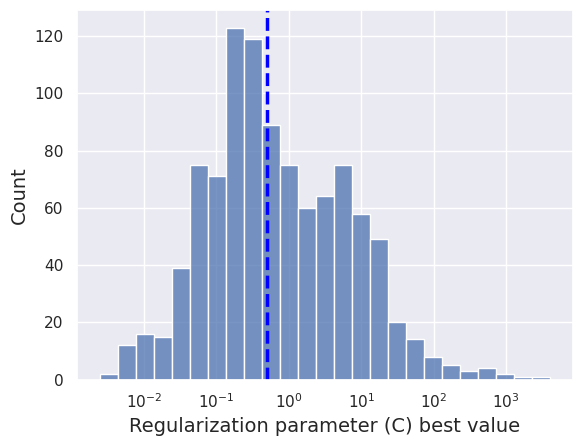

In [44]:
# - CAUTION - uncomment to rerun the gridsearch optimizer. - CAUTION - LONG RUN TIME
capstone_C = Logistic_GS_optimizer(X, y, 1000)

# the histogram of the C values
sns.histplot(data=capstone_C, bins=25, log_scale=True)
plt.xlabel("Regularization parameter (C) best value", size=14)
plt.ylabel("Count", size=14)
plt.axvline(x=np.median(capstone_C),
            color='blue', ls='--', lw=2.5)

In [45]:
plt.savefig("Seaborn_displot_histogram_with_median_line_Python.png")

<Figure size 640x480 with 0 Axes>

##### Based on 1000 loops over our grid search, the median (and likely best) value for the regularization parameter C is about 0.5.  I have hardcoded C below so this notebook can be run for demonstration.

In [47]:
#NOTE: C hard=coded to prevent needing to rerun the hyperparameter fitter above
best_C = np.median(capstone_C)
#best_C = 0.5
print(best_C)

0.4992568385868943


Now we'll actually train the model.  We'll start by splitting the data into train and test sets.

In [48]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y)

print("Shape of the complete data set:", X.shape)
print("Shape of the train data set:", X_train.shape)
print("Shape of the test data set:", X_test.shape)

Shape of the complete data set: (1675, 16)
Shape of the train data set: (1340, 16)
Shape of the test data set: (335, 16)


Next, perform oversampling to balance the classes.

In [49]:
smote = BorderlineSMOTE(sampling_strategy='auto')
smox, smoy = smote.fit_resample(X_train, y_train)

In [50]:
smoy.value_counts()

Phys1_outcome
0    1254
1    1254
Name: count, dtype: int64

...and train the model.  Note that we're pickling the results so we can reload the trained model for prediction of later cohorts.

In [51]:
from sklearn.metrics import classification_report, confusion_matrix

result_pipe = Pipeline([('scaler', StandardScaler()),
                       ('classifier', LogisticRegression(max_iter=1000, C=best_C))]) 
                        
result_pipe.fit(smox.values, smoy.values)

with open('trained-model-physics1.pkl', 'wb') as f:
    pickle.dump(result_pipe, f)

ypred = result_pipe.predict(X_test.values)
print(classification_report(y_test, ypred))
pd.DataFrame(confusion_matrix(y_test, ypred),
             index = ['Successful actual', 'At Risk actual'],
             columns = ['Successful pred', 'At Risk pred'])

              precision    recall  f1-score   support

           0       0.99      0.88      0.93       314
           1       0.30      0.81      0.44        21

    accuracy                           0.87       335
   macro avg       0.64      0.84      0.68       335
weighted avg       0.94      0.87      0.90       335



,Successful pred,At Risk pred
Successful actual,275,39
At Risk actual,4,17


Above is the confusion matrix for the particular train/test split from the last time the model was fit.  There are probably about 50 cadets predicted to be at risk of earning a C- or worse in the test set.  Of these, less than 20 actually earned a grade of C- or lower - we have many "false positives" ("positive" in this case meaning they are predicted to be at risk).  This is actually a good thing!  History is not destiny, and most cadets work hard and pass Physics I, regardless of their prior performance.  The ones we're after here are the ones MOST likely to have a hard time.  Let's see if we can identify them.

### Model Results

We'll start by retrieving the model probabilities.  A probability of 1.0 means the model thinks a cadet is almost certain to ge a C- or woese.

In [52]:
probs=result_pipe.predict_proba(X_test.values)

We can use these probabilityes to evaluate how well our model did.  Here's the precision-recall curve for this run.

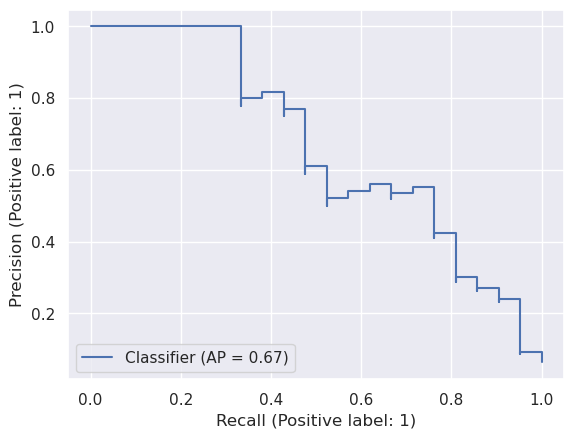

In [53]:
from sklearn.metrics import PrecisionRecallDisplay, RocCurveDisplay

y_preddisp = result_pipe.predict_proba(X_test.values)[:, 1]
PrecisionRecallDisplay.from_predictions(y_test.values, y_preddisp)

plt.show()


There is not as much area under that curve as we'd normally like to see.  The model has a hard time clearly separating "At-risk" cadets from those likely to succeed.  History is not destiny.  

In [54]:
y_out_df = pd.DataFrame(np.array(y_test), columns=['actual'], index=X_test.index)
y_out_df['predicted']=ypred
y_out_df['probability']=probs[:, 1]
y_out_df.head(20)

,actual,predicted,probability
1648,0,0,0.000132
256,0,0,0.066734
73,0,0,0.011504
1490,0,0,0.041516
952,0,0,0.197405
1089,0,0,0.197327
644,0,0,0.000552
1620,1,1,0.949666
1160,0,0,0.006427
115,0,0,0.000018


What about Cohen's kappa?  According to Wikipedia, Cohen's kappa measures the agreement between two raters who each classify N items into C mutually exclusive categories.

In [55]:
lr_kappa = cohen_kappa_score(ypred, y_test)
print(lr_kappa)

0.38553086209102927


A Cohen's kappa of 0.4 indicates "fair to moderate" agreement between our "raters" - one of which is the predicted outcomes, and the other the actual outcomes.

The ROC curve provides another view.  Let's plot it.

In [56]:
y_probs = pd.DataFrame(result_pipe.predict_proba(X_test.values)[:, 1])

In [57]:
prob_at_risk = probs[:,1]
prob_at_risk[:22]

array([1.31575372e-04, 6.67339536e-02, 1.15037111e-02, 4.15159762e-02,
       1.97404809e-01, 1.97326529e-01, 5.51847513e-04, 9.49666296e-01,
       6.42703709e-03, 1.79303719e-05, 5.57484467e-05, 3.05896806e-03,
       9.89399129e-01, 5.82331530e-04, 1.53976059e-01, 9.34344812e-02,
       1.74255896e-01, 9.86674619e-03, 1.09859484e-02, 3.45797750e-02,
       8.57229059e-02, 9.99983820e-01])

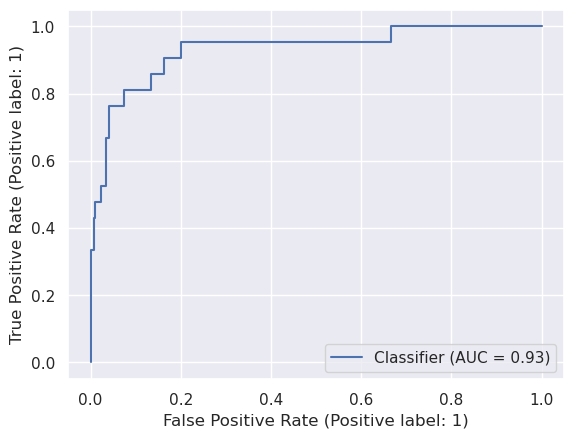

In [58]:
RocCurveDisplay.from_predictions(y_test, y_preddisp)
plt.show()

Again, the false positive rate creeps up as we approach true positive rates of 90%.  The model has difficulty cleanly separating the Successful and At-risk cadets.  Let's look at how many cadets fall into each probability range.

In [59]:
round_prob = [round(num, 3) for num in prob_at_risk]

/home/jdiabl0/anaconda3/envs/TDI/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


<Axes: ylabel='Count'>

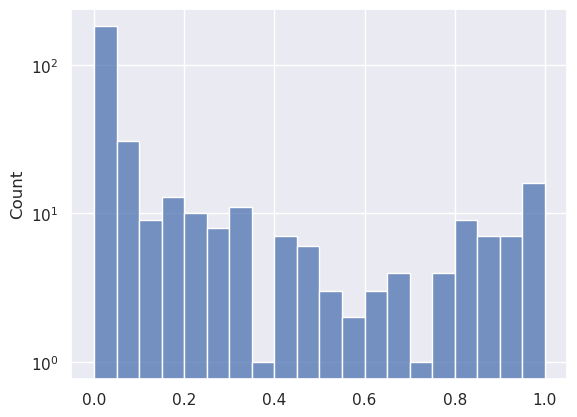

In [60]:
# the histogram of the probabilities
sns.histplot(data=round_prob, bins=20, log_scale=(False, True))

Most hadets are not at risk of dooing poorly in Physics 1 based solely on prior performance.  They fall at the left of this probability histogram.  (Note that the counts in each probability bin are plotted logarithmically.)  Rther than clean separation, or at least having a minimum at 0.5, the natural break appears to be closer to 0.7.  Again, many "at-risk" cadets work hard and do fine.  Let's see if we can narrow things down by seeing if our model precision improves if we set a cutoff at progressively higher probabilities.

In [61]:
y_out_df.loc[y_out_df['probability'] >= .96]

,actual,predicted,probability
776,0,1,0.989399
117,1,1,0.999984
1295,1,1,0.999459
1661,1,1,0.996859
1562,1,1,0.987323
1670,1,1,0.999866
653,0,1,0.960590
68,1,1,0.969746
1371,0,1,0.980592
1563,1,1,0.984363


In [62]:
from sklearn.metrics import accuracy_score
threshold_accuracy=accuracy_score(y_out_df.loc[y_out_df['probability'] >= .96].actual, y_out_df.loc[y_out_df['probability'] >= .96].predicted)

In [63]:
print(threshold_accuracy)

0.7142857142857143


In [64]:
thresholds = 1.5 - np.geomspace(1, .51, num=30)

In [65]:
accuracies = []

for num in thresholds:
    accuracies.append(accuracy_score(y_out_df.loc[y_out_df['probability'] > num].actual,
                                     y_out_df.loc[y_out_df['probability'] > num].predicted))

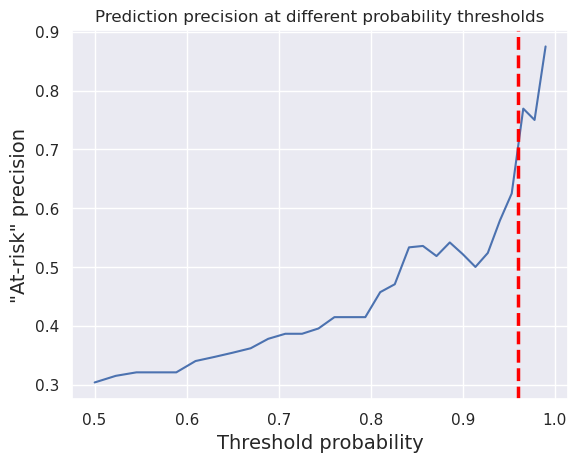

In [66]:
plt.plot(thresholds, accuracies)
plt.xlabel("Threshold probability", size=14)
plt.ylabel('"At-risk" precision', size=14)
plt.title('Prediction precision at different probability thresholds')
plt.axvline(x=0.96, color='red', ls='--', lw=2.5)
plt.show
plt.savefig("Matplotlib_probability_thresholds_w_line.png")

Here we've plotted the precision of the model's "At-risk" prediction vs. the cadet's probability of being at risk.  Precision increases slowly below at-risk probabilities of 0.9, then increases dramatically.  By the time probabiity reaches 0.96, precision is above 80%.  THESE are the cadets we want to make sure we identify, and possibly assign to academic support right at the start of the semester.  We can print out a list, by identifier:

In [67]:
y_out_df.loc[y_out_df['probability'] >= .96]

,actual,predicted,probability
776,0,1,0.989399
117,1,1,0.999984
1295,1,1,0.999459
1661,1,1,0.996859
1562,1,1,0.987323
1670,1,1,0.999866
653,0,1,0.960590
68,1,1,0.969746
1371,0,1,0.980592
1563,1,1,0.984363


Finally, let's see if we can fet some insight into WHY the model thinks they might struggle.  The Locally Interpretable, Model-Agnostic Explainer (LIME) perturbs each data point to see which factors are most significant in the model's prediction.  LIME also provides an Explainer to present its findings graphically.

In [68]:
import lime
import lime.lime_tabular

X_features = ['MATH_3107', 'MATH_3111', 'MATH_3115', 'MATH_3117', 'MATH_3211', 'MATH_3213', 'MATH_3215', 
              'Phys_Prev_Grade_F', 'Phys_Prev_Grade_N', 'HS_GPA', 'SAT_Math', 'SAT_Verbal', 'CGA_GPA', 'Calc_1_times', 'Calc_1_QP', 'Phys_1_times' ]

explainer = lime.lime_tabular.LimeTabularExplainer(np.array(smox),
                                                   feature_names=X_features,
                                                   training_labels=smoy,
                                                   class_names=['Likely successful', 'Likely At-risk'],
                                                   # categorical_features=,
                                                   # There is no categorical features in this example, otherwise specify them.
                                                   verbose=True, mode='classification')

In [69]:
report_at_risk = list(y_out_df.loc[y_out_df['probability'] >= .96].index)

In [70]:
for instance in report_at_risk:
    print(f'Unique ID: {instance}')
    exp = explainer.explain_instance(X_test.loc[instance].values, result_pipe.predict_proba, num_features=6)
    exp.show_in_notebook(show_table=True, show_all=False)

Unique ID: 776
Intercept 0.503779865448045
Prediction_local [0.58678655]
Right: 0.9893991294844144


Unique ID: 117
Intercept 0.16615842524381313
Prediction_local [0.95100943]
Right: 0.9999838196432937


Unique ID: 1295
Intercept 0.08452688111368814
Prediction_local [1.04454448]
Right: 0.9994589291991135


Unique ID: 1661
Intercept 0.31965505404846967
Prediction_local [0.76185188]
Right: 0.9968587658026996


Unique ID: 1562
Intercept 0.2558879367739647
Prediction_local [0.907053]
Right: 0.987323319226497


Unique ID: 1670
Intercept 0.026297841585841364
Prediction_local [1.11174526]
Right: 0.9998661648941484


Unique ID: 653
Intercept 0.5315940413342379
Prediction_local [0.53867066]
Right: 0.9605901965644391


Unique ID: 68
Intercept 0.19576958975524777
Prediction_local [0.84003966]
Right: 0.9697463488371882


Unique ID: 1371
Intercept 0.2460397534587322
Prediction_local [0.88513479]
Right: 0.9805917203431727


Unique ID: 1563
Intercept 0.25577741626368133
Prediction_local [0.88820092]
Right: 0.9843631005714206


Unique ID: 1669
Intercept 0.24296333269393736
Prediction_local [0.87741285]
Right: 0.9983776006823636


Unique ID: 168
Intercept 0.12594496119059936
Prediction_local [0.93815738]
Right: 0.9977592564930636


Unique ID: 332
Intercept 0.31145174102656303
Prediction_local [0.80224435]
Right: 0.9912469797029299


Unique ID: 1433
Intercept 0.12213922849761394
Prediction_local [1.01151767]
Right: 0.9977214580745496


According to LIME, the cadets most at-risk to struggle in Physics 1 are usually those with a low GPA at the Academy, regardless of earlier GPA, standardided test scores (which rarely appear), or other factors.  Poor performance in Calc I or placement into Math 3107 are also frequently in the top reasons a cadet is likely at risk.  These explanations may be useful in targeting appropriate inteventions.

## Predict at-risk cadets for a new cohort

To make predictions on a new cohort of Physics I cadets, we'll start by importing their institutional data.  The data format should be a .CSV file with the fields described in the "Model Training" section above. We dropped drop the 'Gender' and 'Ethnicity' columns during training data import, on the grounds that these may bias our results. We also dropped the "AcademicClassYr" column, since year-on-year performance should be roughly similar. We'll drop them from the prediction set as well.  We'll likewise drop the "Calc1Grade" column, since we'll use each cadet's Calc 1 Quality Points as the performance indicator.

In [71]:
pred_df = pd.read_csv("./pred-inst.csv", index_col=0)

pred_df.drop(columns=['Gender', 'AcademicClassYr', 'Ethnicity'], inplace=True)
pred_df['MathPlacement'] = pred_df['MathPlacement'].astype(str) #Set MathPlacement (class number) as string
pred_inst = pred_df.drop(columns=['Calc1LastGrade'])

pred_df.shape

(288, 11)

In the training data, bout 300 records were missing values for 'Calc1LastGrade' and 'Calc1LastQP'. This could be because their math placement exam placed them into a class higher than Calc 1, or because they hadn't yet taken Calc 1. If the former, their effective Calc 1 grade should be 'A' and their Calc 1 Quality Points should be 4.0. For those cadets, their effective Calc1Number was set to 1. For the others, their QP was set to 0.0.  We'll apply the same replacement to the prediction data.

In [72]:
pred_inst['Calc1LastQP'] = pred_inst.apply(lambda row: 
                                             0.0 
                                             if pd.isnull(row['Calc1LastQP']) and int(row['MathPlacement']) <= 3111
                                             else row['Calc1LastQP'], axis=1)

pred_inst['Calc1LastQP'] = pred_inst.apply(lambda row: 
                                             4.0 
                                             if pd.isnull(row['Calc1LastQP']) and int(row['MathPlacement']) > 3111
                                             else row['Calc1LastQP'], axis=1)

pred_inst['Calc1Number'] = pred_inst.apply(lambda row: 
                                             1 
                                             if int(row['MathPlacement']) > 3111
                                             else row['Calc1Number'], axis=1)

We'll get all of the HS GPAs on the same scale...

In [73]:
pred_inst['HS_Gpct'] = pred_inst.HSGPA / pred_inst.MaxHS_GPA_Scale
pred_inst.HS_Gpct.replace([np.inf, -np.inf], np.nan, inplace=True)
pred_inst['HS_Gpct'] = pred_inst.apply(lambda row: 
                                             row['LastGPA'] /4.0
                                             if pd.isnull(row['HS_Gpct'])
                                             else row['HS_Gpct'], axis=1)

In [74]:
pred_inst.info()

<class 'pandas.core.frame.DataFrame'>
Index: 288 entries, 1685 to 1972
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   MathPlacement    288 non-null    object 
 1   LastGPA          288 non-null    float64
 2   HSGPA            288 non-null    float64
 3   MaxHS_GPA_Scale  288 non-null    float64
 4   TestUsed         288 non-null    object 
 5   MaxMath          288 non-null    int64  
 6   MaxVerbal        288 non-null    int64  
 7   Calc1Number      288 non-null    int64  
 8   Calc1LastQP      288 non-null    float64
 9   PhysicsITimes    288 non-null    int64  
 10  HS_Gpct          288 non-null    float64
dtypes: float64(5), int64(4), object(2)
memory usage: 27.0+ KB


...and fill any missing GPAs with their CGA GPA.

In [75]:
pred_inst.HS_Gpct.replace([np.inf, -np.inf], np.nan, inplace=True)  #taking care of some pesky inf values

In [76]:
pred_inst['HS_Gpct'] = pred_inst.apply(lambda row: 
                                             row['LastGPA']/4.0 
                                             if pd.isnull(row['HS_Gpct'])
                                             else row['HS_Gpct'], axis=1)

In [77]:
pred_inst.head()

,MathPlacement,LastGPA,HSGPA,MaxHS_GPA_Scale,TestUsed,MaxMath,MaxVerbal,Calc1Number,Calc1LastQP,PhysicsITimes,HS_Gpct
RecordNum,,,,,,,,,,,
1685,3107,3.62,95.60,100.0,ACT,0,0,1,0.0,0,0.9560
1686,3111,2.23,96.94,100.0,ACT,0,0,1,2.7,0,0.9694
1687,3107,3.30,3.94,4.0,ACT,0,0,0,0.0,0,0.9850
1688,3115,3.14,3.66,4.0,ACT,0,0,1,4.0,0,0.9150
1689,3111,3.53,0.00,0.0,SAT,530,560,1,3.3,0,0.8825


For the class years 2020-2025, the mean SAT Math score was 655, and the mean SAT Verbal Score was 652.  In the training results, standardized test scores were never strongly predictive of the cadets most-at-risk.  For prediction purposes, we'll fill any missing standardized test scores (reported as 0 in the input .csv file) with the corresponding mean score.

In [78]:
SAT_Math_avg = 655
SAT_Verbal_avg = 652

pred_inst['MaxMath'].replace(0, 655, inplace=True)
pred_inst['MaxVerbal'].replace(0, 652, inplace=True)
pred_inst.head()

,MathPlacement,LastGPA,HSGPA,MaxHS_GPA_Scale,TestUsed,MaxMath,MaxVerbal,Calc1Number,Calc1LastQP,PhysicsITimes,HS_Gpct
RecordNum,,,,,,,,,,,
1685,3107,3.62,95.60,100.0,ACT,655,652,1,0.0,0,0.9560
1686,3111,2.23,96.94,100.0,ACT,655,652,1,2.7,0,0.9694
1687,3107,3.30,3.94,4.0,ACT,655,652,0,0.0,0,0.9850
1688,3115,3.14,3.66,4.0,ACT,655,652,1,4.0,0,0.9150
1689,3111,3.53,0.00,0.0,SAT,530,560,1,3.3,0,0.8825


In [79]:
def prevgrade(row):
    
    if row['PhysicsITimes'] == 0:
        outcome = 'N'
    else:
        outcome = 'F'
        
    return outcome    

In [80]:
pred_inst['P1_PrevGrade'] = pred_inst.apply(lambda row: prevgrade(row), axis=1)

In [81]:
pred_inst.head()

,MathPlacement,LastGPA,HSGPA,MaxHS_GPA_Scale,TestUsed,MaxMath,MaxVerbal,Calc1Number,Calc1LastQP,PhysicsITimes,HS_Gpct,P1_PrevGrade
RecordNum,,,,,,,,,,,,
1685,3107,3.62,95.60,100.0,ACT,655,652,1,0.0,0,0.9560,N
1686,3111,2.23,96.94,100.0,ACT,655,652,1,2.7,0,0.9694,N
1687,3107,3.30,3.94,4.0,ACT,655,652,0,0.0,0,0.9850,N
1688,3115,3.14,3.66,4.0,ACT,655,652,1,4.0,0,0.9150,N
1689,3111,3.53,0.00,0.0,SAT,530,560,1,3.3,0,0.8825,N


In [82]:
pred_input = pred_inst.copy()

In [83]:
features_to_use = ['MathPlacement','HS_Gpct', 'MaxMath', 'MaxVerbal', 'LastGPA', 'Calc1Number', 
                   'Calc1LastQP', 'PhysicsITimes', 'P1_PrevGrade']
pred_X_m = pred_input[features_to_use]

Now we'll encode the columns in preparation for sampling and classification.  As we did for the training data, we'll need to select and transform the columns we want to feed into our trained model for prediction. MathPlacement is categorical and will need to be OneHotEncoded. We'll also keep HS_Gpct, LastGPA, MaxMath, MaxVerbal, Calc1Number, Calc1LastQP, and PhysicsITimes. We'll use to predict the likely outcome (Physics 1 Successful vs. Unsuccessful).

In [84]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder

columns_to_encode = ['MathPlacement', 'P1_PrevGrade']
ohe = OneHotEncoder()

ohe_trans = ColumnTransformer([
    ('OHE', ohe, columns_to_encode)], 
    remainder='passthrough')

pred_X_encoded = ohe_trans.fit_transform(pred_X_m)
pred_Xenc_cols = ohe_trans.get_feature_names_out()

In [85]:
pred_X=pd.DataFrame(pred_X_encoded, columns=pred_Xenc_cols)
pred_X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 288 entries, 0 to 287
Data columns (total 14 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   OHE__MathPlacement_3107   288 non-null    float64
 1   OHE__MathPlacement_3111   288 non-null    float64
 2   OHE__MathPlacement_3115   288 non-null    float64
 3   OHE__MathPlacement_3211   288 non-null    float64
 4   OHE__MathPlacement_3213   288 non-null    float64
 5   OHE__MathPlacement_3215   288 non-null    float64
 6   OHE__P1_PrevGrade_N       288 non-null    float64
 7   remainder__HS_Gpct        288 non-null    float64
 8   remainder__MaxMath        288 non-null    float64
 9   remainder__MaxVerbal      288 non-null    float64
 10  remainder__LastGPA        288 non-null    float64
 11  remainder__Calc1Number    288 non-null    float64
 12  remainder__Calc1LastQP    288 non-null    float64
 13  remainder__PhysicsITimes  288 non-null    float64
dtypes: float64

In [86]:
trained_columns_in = ['OHE__MathPlacement_3107', 'OHE__MathPlacement_3111','OHE__MathPlacement_3115',
                      'OHE__MathPlacement_3117', 'OHE__MathPlacement_3211','OHE__MathPlacement_3213',
                      'OHE__MathPlacement_3215', 'OHE__P1_PrevGrade_F', 'OHE__P1_PrevGrade_N', 'remainder__HS_Gpct',
                      'remainder__MaxMath', 'remainder__MaxVerbal', 'remainder__LastGPA', 'remainder__Calc1Number',
                      'remainder__Calc1LastQP','remainder__PhysicsITimes']
for column_name in trained_columns_in:
    if column_name not in pred_X.columns:
        pred_X[column_name] = 0
        
pred_X = pred_X.reindex(columns=trained_columns_in)

In [87]:
pred_X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 288 entries, 0 to 287
Data columns (total 16 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   OHE__MathPlacement_3107   288 non-null    float64
 1   OHE__MathPlacement_3111   288 non-null    float64
 2   OHE__MathPlacement_3115   288 non-null    float64
 3   OHE__MathPlacement_3117   288 non-null    int64  
 4   OHE__MathPlacement_3211   288 non-null    float64
 5   OHE__MathPlacement_3213   288 non-null    float64
 6   OHE__MathPlacement_3215   288 non-null    float64
 7   OHE__P1_PrevGrade_F       288 non-null    int64  
 8   OHE__P1_PrevGrade_N       288 non-null    float64
 9   remainder__HS_Gpct        288 non-null    float64
 10  remainder__MaxMath        288 non-null    float64
 11  remainder__MaxVerbal      288 non-null    float64
 12  remainder__LastGPA        288 non-null    float64
 13  remainder__Calc1Number    288 non-null    float64
 14  remainder_

In [88]:
import pickle

pred_X.to_pickle('pred_cleaned_X.pkl')

Let's import what we need for the predictions.

In [89]:
from imblearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import BorderlineSMOTE
from sklearn.metrics import cohen_kappa_score, make_scorer

In [90]:
#NOTE: C hard=coded to prevent needing to rerun the hyperparameter fitter above
best_C = 0.5
print(best_C)

0.5


Now we'll load the trained pipeline that we'll use to predict outcomes.

In [91]:
with open('trained-model-physics1.pkl', 'wb') as f:
    loaded_model = pickle.dump(result_pipe, f)

In [92]:
cohort_pred = result_pipe.predict(pred_X.values)
cohort_probs=result_pipe.predict_proba(pred_X.values)

In [93]:
cohort_out_df = pd.DataFrame(cohort_pred, columns=['predicted_at_risk'], index=pred_X.index)
#cohort_out_df['predicted']=ypred
cohort_out_df['probability']=cohort_probs[:, 1]
cohort_out_df.head(20)

,predicted_at_risk,probability
0,0,0.218240
1,0,0.112614
2,0,0.236632
3,0,0.000071
4,0,0.000357
5,0,0.042369
6,0,0.000016
7,1,0.990959
8,1,0.612514
9,1,0.939588


The model has predicted the probable outcome in Physics I for each cadet, based solely on their prior performance.  As noted above, prior performance is not the only predictor of future performance; what a cadet actually does during the semester is of far greater importance.  Most cadets predicted to struggle in Physics I will work hard and succeed.  However, those most likely to be at risk may need extra support and should be placed in academic support at the earliest sign of difficulty.  Let's identify those most at risk, using the 96% threshold from training.

In [94]:
cohort_out_df.loc[cohort_out_df['probability'] >= .96]

,predicted_at_risk,probability
7,1,0.990959
25,1,0.989716
41,1,0.995949
85,1,0.998501
98,1,0.988049
127,1,0.989413
170,1,0.992875
175,1,0.972532
182,1,0.990587
189,1,0.995433


For the cohort in Physics I at the time this tool was developed, 11 cadets were predicted to be most-at-risk at the beginning of the semester.  Let's generate At-Risk Reports for those cadets.

In [95]:
import lime
import lime.lime_tabular

X_features = ['MATH_3107', 'MATH_3111', 'MATH_3115', 'MATH_3117', 'MATH_3211', 'MATH_3213', 'MATH_3215', 
              'Phys_Prev_Grade_F', 'Phys_Prev_Grade_N', 'HS_GPA', 'SAT_Math', 'SAT_Verbal', 'CGA_GPA', 'Calc_1_times', 'Calc_1_QP', 'Phys_1_times' ]

explainer = lime.lime_tabular.LimeTabularExplainer(np.array(pred_X.values),
                                                   feature_names=X_features,
                                                   training_labels=cohort_pred,
                                                   class_names=['Likely successful', 'Likely At-risk'],
                                                   # categorical_features=,
                                                   # There is no categorical features in this example, otherwise specify them.
                                                   verbose=True, mode='classification')

In [96]:
report_at_risk = list(cohort_out_df.loc[cohort_out_df['probability'] >= .96].index)

In [97]:
for instance in report_at_risk:
    print(f'Unique ID: {instance}')
    exp = explainer.explain_instance(pred_X.loc[instance].values, result_pipe.predict_proba, num_features=6)
    exp.show_in_notebook(show_table=True, show_all=False)

Unique ID: 7
Intercept 0.12951151614220444
Prediction_local [0.54908339]
Right: 0.9909593669552249


Unique ID: 25
Intercept 0.14493360116954385
Prediction_local [0.55378689]
Right: 0.9897160132463158


Unique ID: 41
Intercept 0.15270398179585146
Prediction_local [0.53030169]
Right: 0.9959493987794567


Unique ID: 85
Intercept 0.10486694404541919
Prediction_local [0.58354095]
Right: 0.9985011596098795


Unique ID: 98
Intercept 0.06869421504216061
Prediction_local [0.60826168]
Right: 0.9880493389474682


Unique ID: 127
Intercept 0.1281353274253903
Prediction_local [0.53011899]
Right: 0.9894128490128221


Unique ID: 170
Intercept 0.12423715218915869
Prediction_local [0.50777972]
Right: 0.9928751120071616


Unique ID: 175
Intercept 0.2253539734384509
Prediction_local [0.49885476]
Right: 0.9725321638986063


Unique ID: 182
Intercept 0.08940229757872963
Prediction_local [0.5264823]
Right: 0.9905871775068021


Unique ID: 189
Intercept 0.14597466620321153
Prediction_local [0.54428585]
Right: 0.9954327993404484


Unique ID: 213
Intercept 0.12502984911408946
Prediction_local [0.5369877]
Right: 0.9846078796613918


These results can now be used to monitor at-risk cadets, or to fill academic support programs for the first weeks of the semester.